In [1]:
import math
import numpy as np

from PIL import Image
from PIL import ImageFilter

# Image Preprocessing

 [Pillow](https://pillow.readthedocs.io/en/stable/handbook/tutorial.html). Por supuesto, hay paquetes como OpenCV, pero en realidad están destinados a realizar tareas de visión por computadora una vez que tenga las imágenes listas.

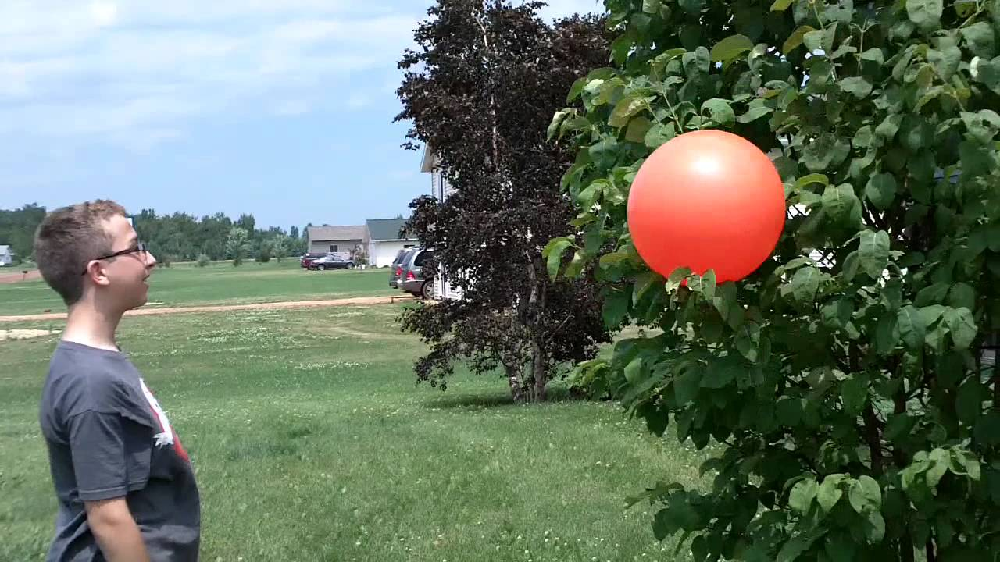

In [2]:
im = Image.open('ball.jpeg')
display(im)

## Cropping

A veces, solo requerimos hacer manipulaciones básicas a nuestra imagen. El más común de ellos es el cultivo. Por ejemplo, podríamos intentar recortar la pelota.

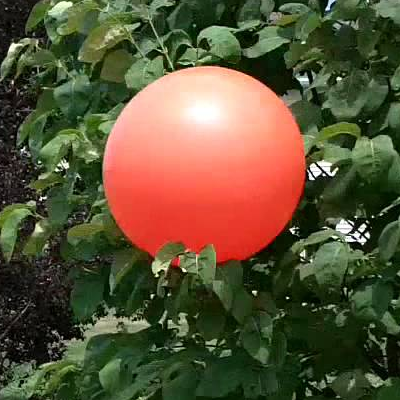

In [3]:
# box = (left, upper, right, lower)

box = (700, 100, 1100, 500)
ball = im.crop(box)

display(ball)

## Rotations and Scalings

Una vez que tenemos nuestra imagen recortada, a veces queremos aplicarle transformaciones para generar un conjunto de imágenes de datos aumentados para su conjunto de entrenamiento. Esto se logra fácilmente con PIL.

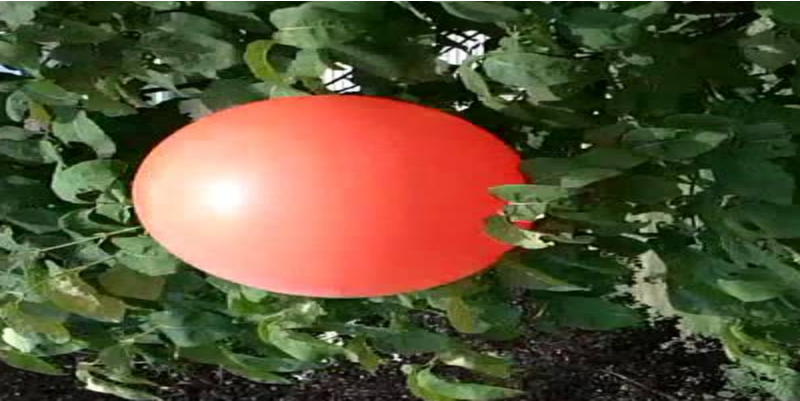

In [4]:
def scale_and_rotate_image(im, sx, sy, deg_ccw):
    im_orig = im
    im = Image.new('RGBA', im_orig.size, (255, 255, 255, 255))
    im.paste(im_orig)

    w, h = im.size
    angle = math.radians(-deg_ccw)

    cos_theta = math.cos(angle)
    sin_theta = math.sin(angle)

    scaled_w, scaled_h = w * sx, h * sy

    new_w = int(math.ceil(math.fabs(cos_theta * scaled_w) + math.fabs(sin_theta * scaled_h)))
    new_h = int(math.ceil(math.fabs(sin_theta * scaled_w) + math.fabs(cos_theta * scaled_h)))

    cx = w / 2.
    cy = h / 2.
    tx = new_w / 2.
    ty = new_h / 2.

    a = cos_theta / sx
    b = sin_theta / sx
    c = cx - tx * a - ty * b
    d = -sin_theta / sy
    e = cos_theta / sy
    f = cy - tx * d - ty * e

    return im.transform(
        (new_w, new_h),
        Image.AFFINE,
        (a, b, c, d, e, f),
        resample=Image.BILINEAR
    )


rotated_ball = scale_and_rotate_image(ball, 1.0, 2.0, 90)
display(rotated_ball)

## Color Channels

Las computadoras no "ven" las imágenes de la misma manera que nosotros. Como nos enseñan en la escuela, los colores primarios son rojo, amarillo y azul y estos colores pueden formar todos los demás colores. Hemos optado por representar los colores en las computadoras de manera similar. A menudo representamos cada color como una combinación de 3 o 4 canales. El más común es RGBA:

- R: rojo
- G: verde
- B: azul
- A: alfa (transparencia)

¿Podemos usar esto para automatizar la búsqueda de la pelota?

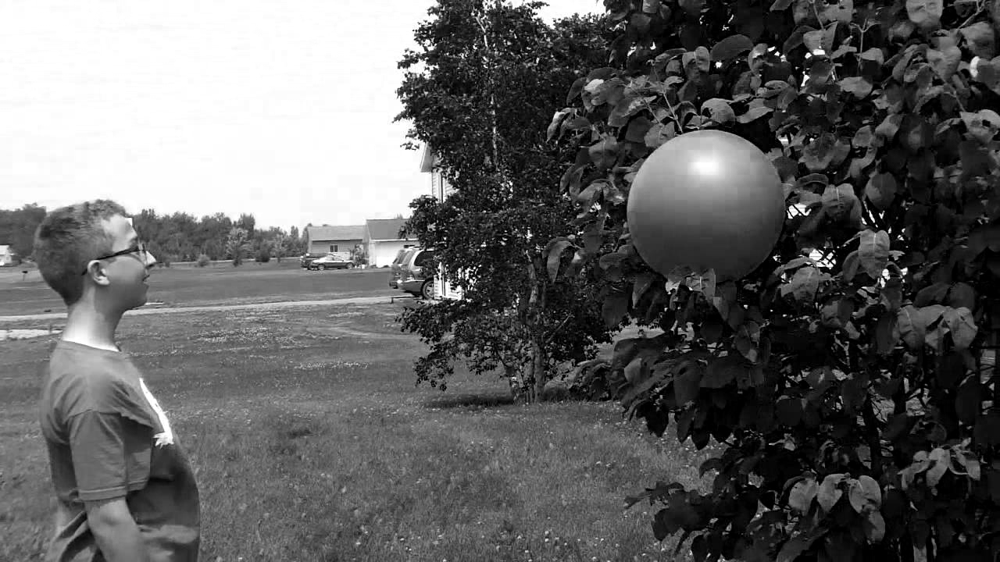

In [5]:
r, g, b = im.split()

display(b)

1. La función find_largest_patch toma tres argumentos: im, que es la imagen en la que se busca el parche, y patch_w y patch_h, que son las dimensiones (ancho y alto) del parche que se busca.

2. La primera línea de la función, w, h = im.size, asigna las dimensiones de la imagen a las variables w y h.

3. La siguiente línea, arr = np.zeros((w, h)), crea una matriz numpy de tamaño w x h que se utilizará para almacenar los píxeles de la imagen que superen un cierto umbral (el valor de umbral se define más adelante).

4. La siguiente línea, thresh = 200, establece el umbral para determinar si un píxel debe ser considerado en el parche o no. En este caso, cualquier píxel con un valor mayor a 200 se considerará en el parche.

5. El bucle for anidado en las líneas 7-10 recorre cada píxel de la imagen (i recorre las filas y j las columnas). Si el valor del píxel es mayor que el umbral thresh, se establece el valor correspondiente en la matriz arr como 1.

6. Los siguientes dos bucles for anidados en las líneas 13-17 buscan el parche más grande en la imagen. Comienzan en la esquina superior izquierda de la imagen y avanzan hacia abajo y hacia la derecha. Para cada posición, se extrae un parche de tamaño patch_w x patch_h de la matriz arr y se calcula la suma de todos los elementos del parche. Si la suma es mayor que la variable largest (que se inicializa en 0), se actualiza largest y se guarda la posición actual en la variable indices.

7. Finalmente, la función devuelve las coordenadas i y j del parche más grande, así como su ancho w y alto h.

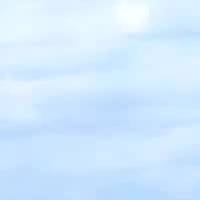

In [6]:
def find_largest_patch(im, patch_w, patch_h):

    w, h = im.size
    arr = np.zeros((w, h))
    
    thresh = 200
    
    for i in range(w):
        for j in range(h):
            if im.getpixel((i, j)) > thresh:
                arr[i, j] = 1
                
    # brute force very slow!!!
    largest = 0
    indices = (0, 0)
    
    for i in range(w-patch_w):
        for j in range(h-patch_h):
            if arr[i:i+patch_w, j:j+patch_h].sum() > largest:
                largest = arr[i:i+patch_w, j:j+patch_h].sum()
                indices = (i, j)
    
                
    return indices[0], indices[1], patch_w, patch_h

i, j, w, h = find_largest_patch(b, 200, 200)

box = (i, j, i+w, j+h)
ball = im.crop(box)

display(ball)

## Other Channels

Como se mencionó, RGB es el canal más común y conduce a encontrar colores muy brillantes que contienen mucho de uno de los colores primarios (como una bola naranja que tiene mucho rojo). Pero, ¿qué pasa si queremos aislar algo que tiene un color bastante "mezclado" como el granero en este ejemplo?

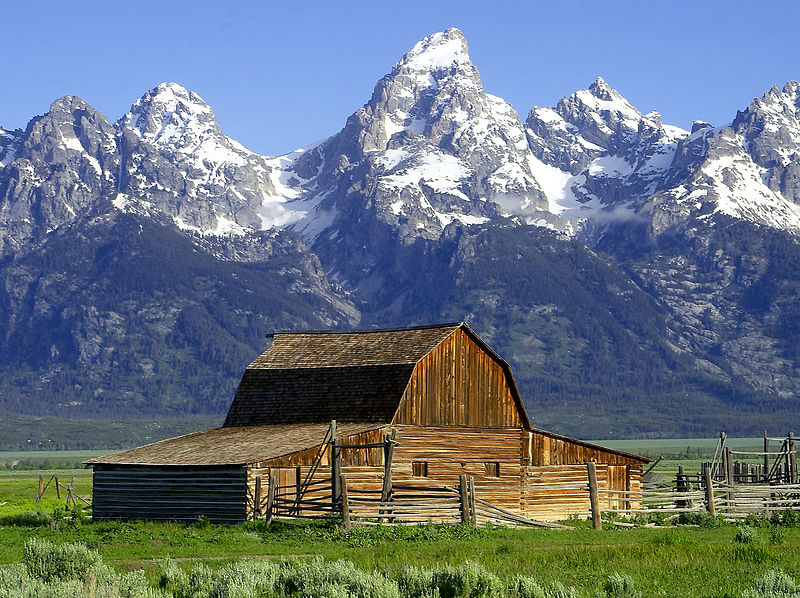

In [7]:
im = Image.open('grand_tetons.jpg')
display(im)

In [10]:
im.split?

Signature: im.split()
Docstring:
Split this image into individual bands. This method returns a
tuple of individual image bands from an image. For example,
splitting an "RGB" image creates three new images each
containing a copy of one of the original bands (red, green,
blue).

If you need only one band, :py:meth:`~PIL.Image.Image.getchannel`
method can be more convenient and faster.

:returns: A tuple containing bands.
File:      c:\users\windows\appdata\roaming\python\python39\site-packages\pil\image.py
Type:      method

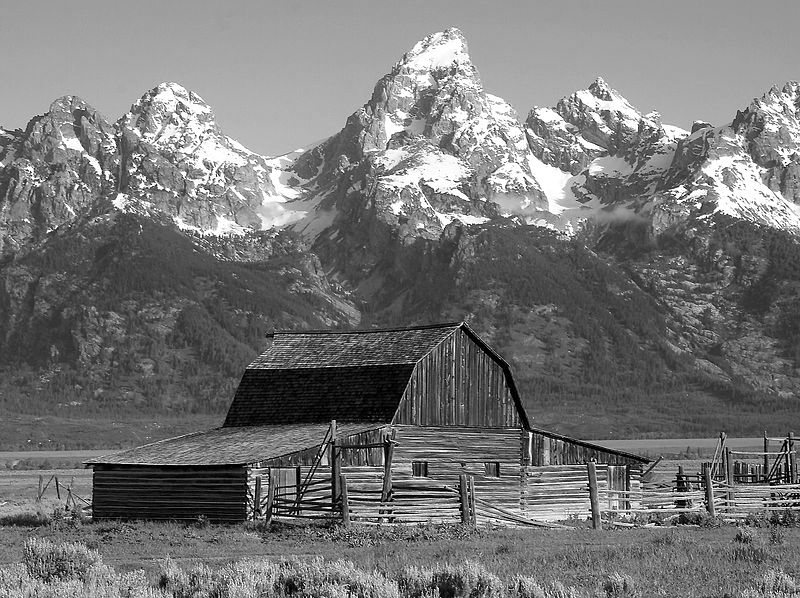

In [8]:
r, g, b = im.split()

display(g)

Como mencioné anteriormente, las computadoras no "ven" el color y, por lo tanto, no están restringidas a pensar en los colores primarios. Pueden cambiar sus colores "base" a otra cosa. Por ejemplo, en la impresión, utilizan CMYK.

- C: cian
- M: Magenta
- Y: amarillo
- K: Clave - el negro de la imagen

Podemos usar estos diferentes sistemas para ayudar a nuestros algoritmos a detectar características en nuestras imágenes.

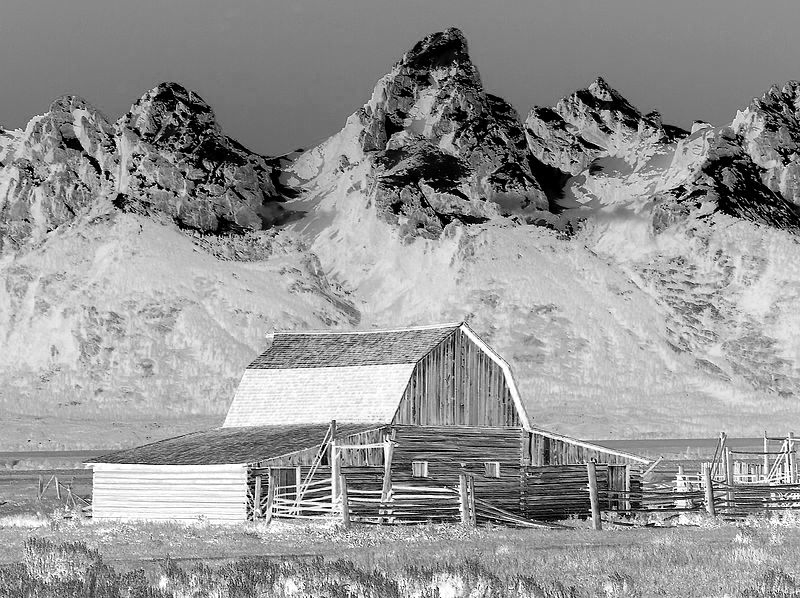

In [11]:
im = im.convert('CMYK')

c, m, y, k = im.split()

display(c)

En este caso, CMYK no ayuda mucho, pero podemos hacer algunas cosas divertidas como hacer que el canal magenta sea más intenso y ver el efecto. Podemos usar el método `.point()` que es similar a la función `apply()` de Pandas.

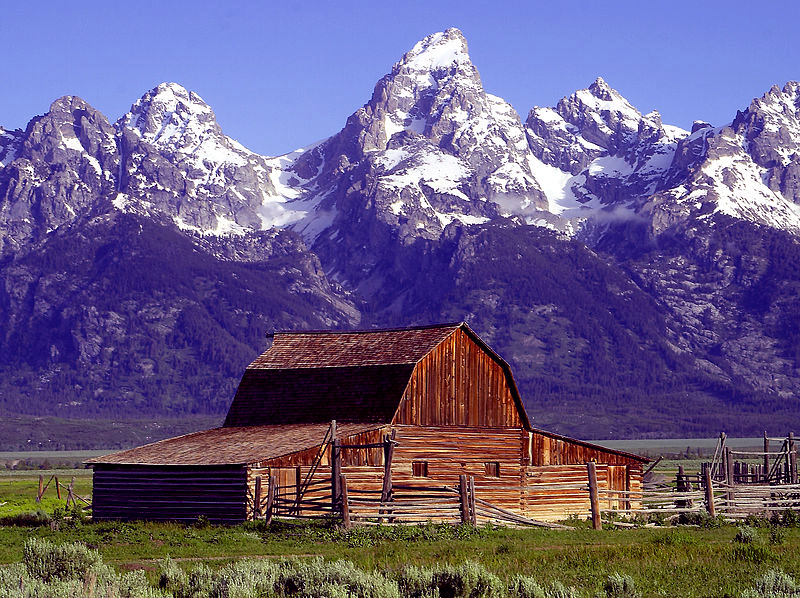

In [12]:
m = m.point(lambda i: i * 1.2)
new_im = Image.merge('CMYK', (c,m,y,k)).convert('RGB')

display(new_im)

Por supuesto, existe el modo de escala de grises para las imágenes, que es 'L', pero el último del que quiero hablar es HSV.

- H: Matiz
- S: Saturación
- V: Valor

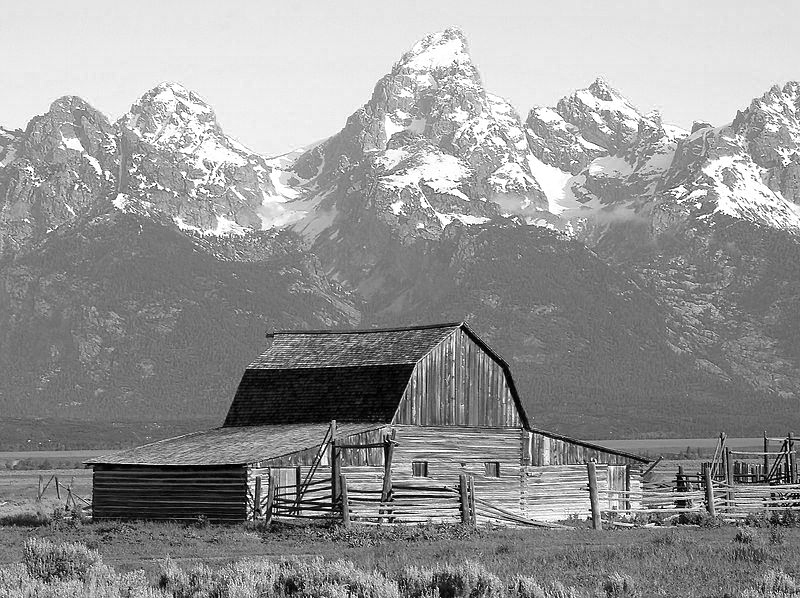

In [13]:
im = Image.open('grand_tetons.jpg')
im = im.convert('HSV')

h, s, v = im.split()

display(v)

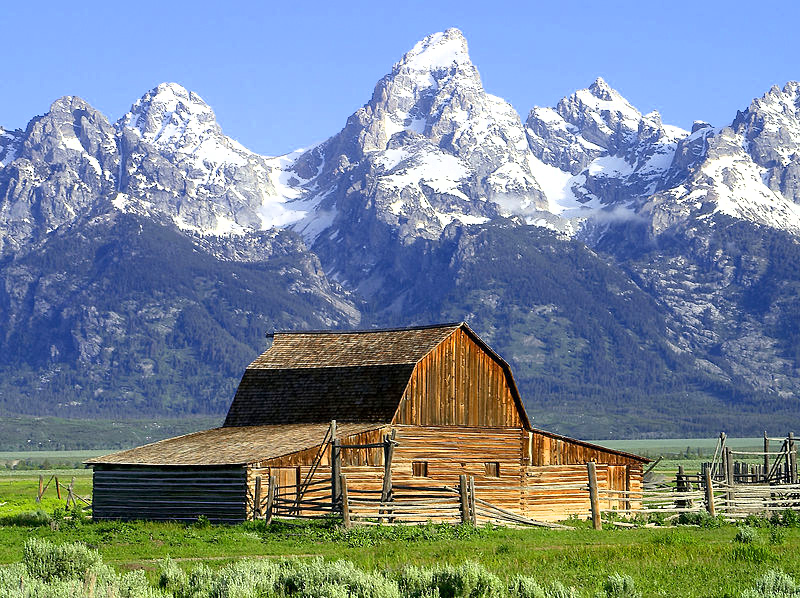

In [14]:
v = v.point(lambda i: i * 1.2)
new_im = Image.merge('HSV', (h,s,v)).convert('RGB')

display(new_im)

## Enhancements & Filtros

Lo último que se suele hacer con las imágenes es aplicar filtros. Estás familiarizado con estos debido a Instagram. En PIL, hay un par de filtros incorporados que se pueden usar. Aquí están los más comunes.

### Edge Finding

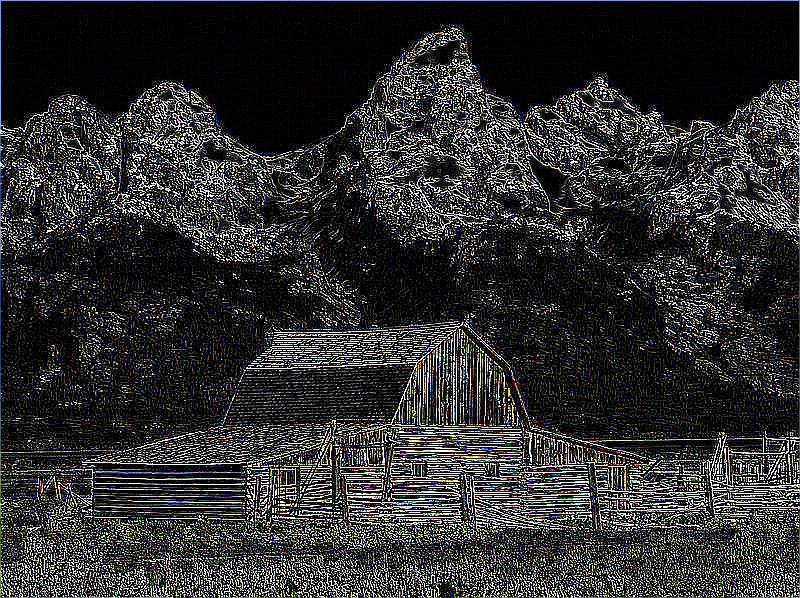

In [15]:
im = Image.open('grand_tetons.jpg')
out = im.filter(ImageFilter.FIND_EDGES)

display(out)

### Enhance (como las peliculas pero no tanto)

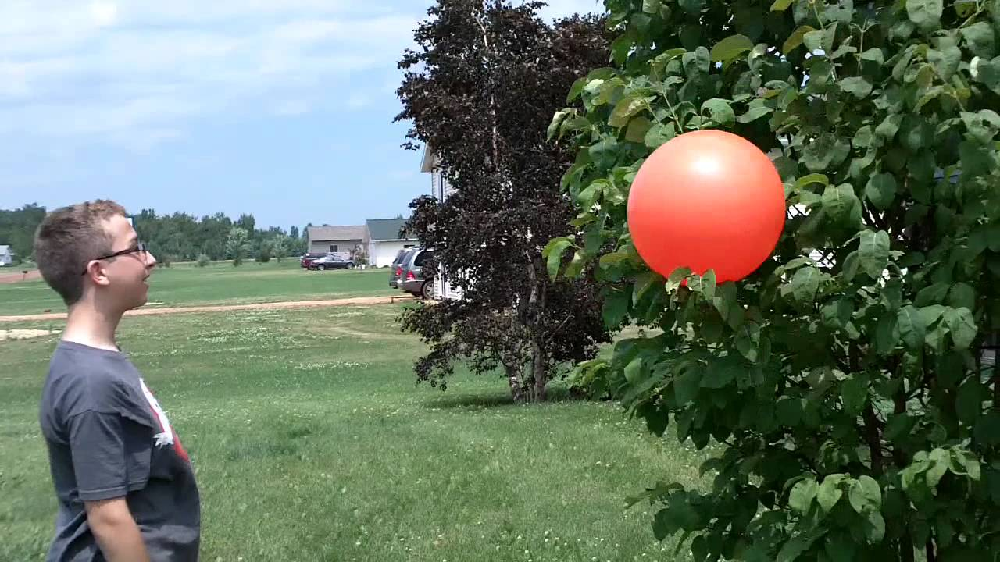

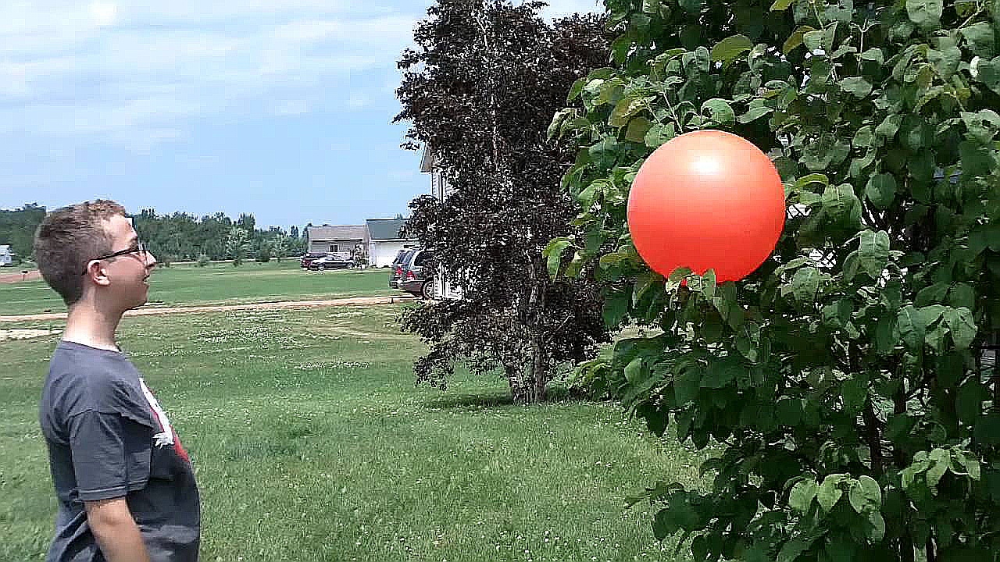

In [16]:
im = Image.open('ball.jpeg')
display(im)

out = im.filter(ImageFilter.EDGE_ENHANCE)
display(out)

Incluso podemos aplicar nuestros propios filtros si sabemos cómo construirlos. Esto se hace usando kernels.

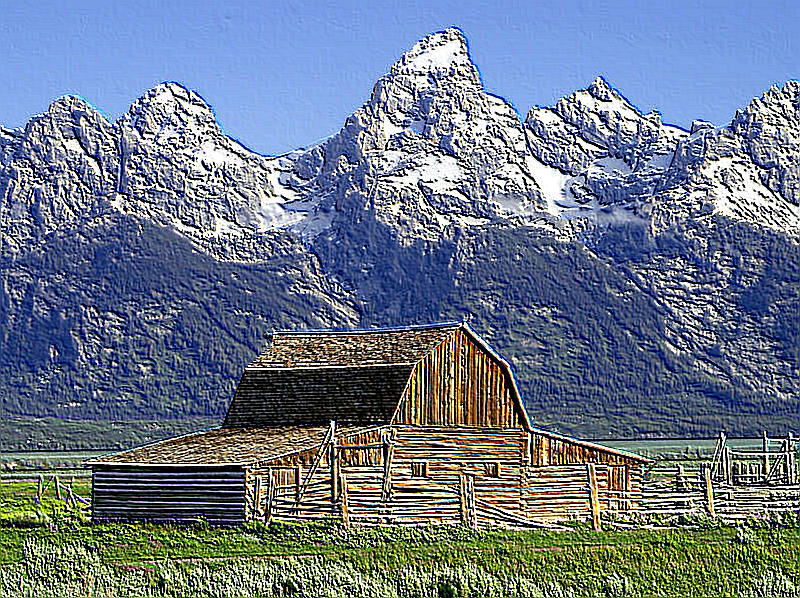

In [17]:
im = Image.open('grand_tetons.jpg')

km = (
     -2, -1,  0,
     -1,  1,  1,
      0,  1,  2
)

# edge kernel

edge_km = (
    -1, -1, -1,
    -1, 8, -1,
    -1, -1, -1
)

scale = 1 if abs(sum(km)) == 0 else abs(sum(km))

k = ImageFilter.Kernel(
    size=(3, 3),
    kernel=km,
    scale=scale,
    offset=0
)

out = im.filter(k)

display(out)

El último filtro del que quiero hablar es el filtro de modo. Simplemente toma el píxel del valor del modelo en cada cuadro NxN de la imagen. Esto puede comprimir imágenes y eliminar el ruido.

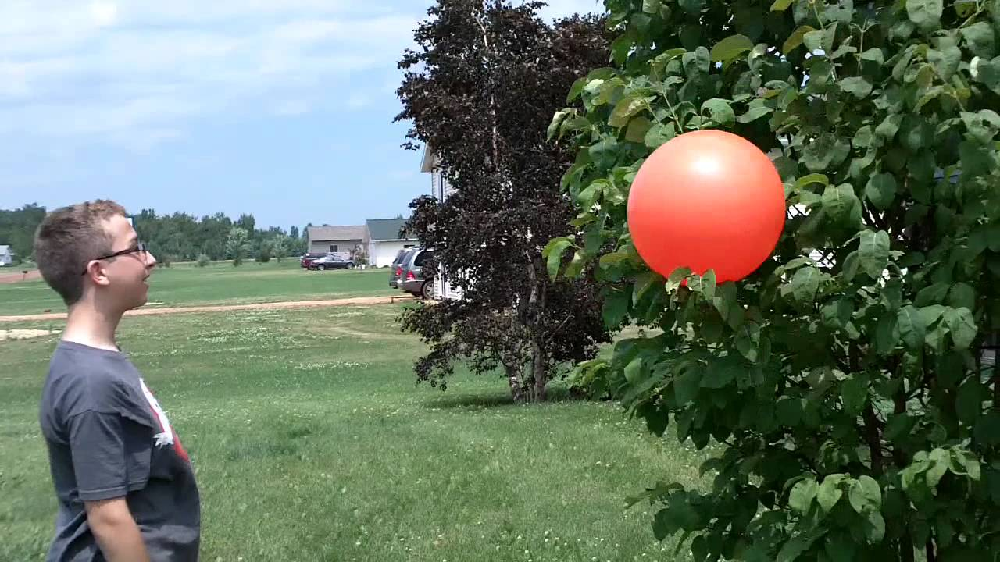

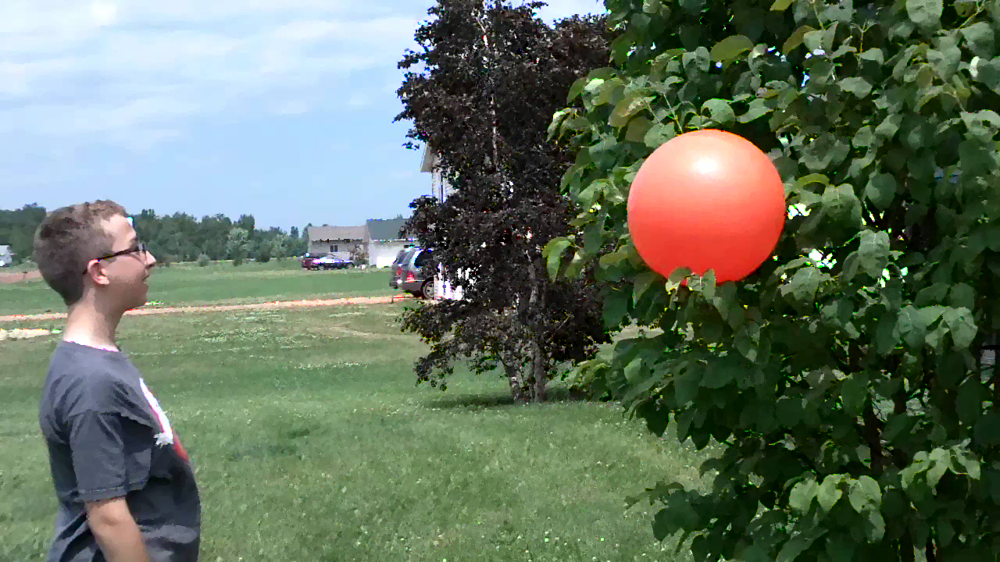

In [18]:
im = Image.open('ball.jpeg')
display(im)

out = im.filter(ImageFilter.ModeFilter(5))
display(out)

Lo último que quiero mencionar es que se realiza una gran cantidad de preprocesamiento de imágenes con el fin de aumentar los datos. Es decir, solo tenemos 100 imágenes y queremos darle a nuestro algoritmo de entrenamiento muchas más imágenes para que el modelo esté mejor entrenado. Podemos rotar, recortar y estirar imágenes para generar muchas imágenes. Pero como sigo mencionando, las computadoras no ven el color. Para ellos, un píxel blanco (0,0,0) y un píxel negro (255,255,255) es tan diferente como un píxel azul (0,0,255) y ligeramente azul (0,0,125). Por lo tanto, a veces queremos aumentar nuestras imágenes con ruido aleatorio para que el algoritmo pueda aprender que las variaciones menores en los píxeles no importan. Para hacer esto, a menudo aplicamos ruido a la imagen.

### Gaussian Noise

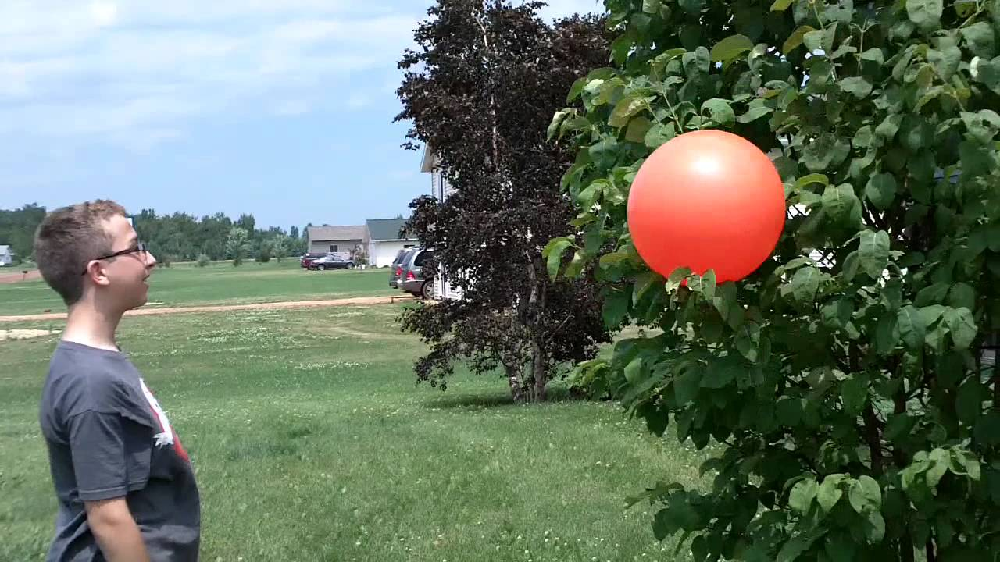

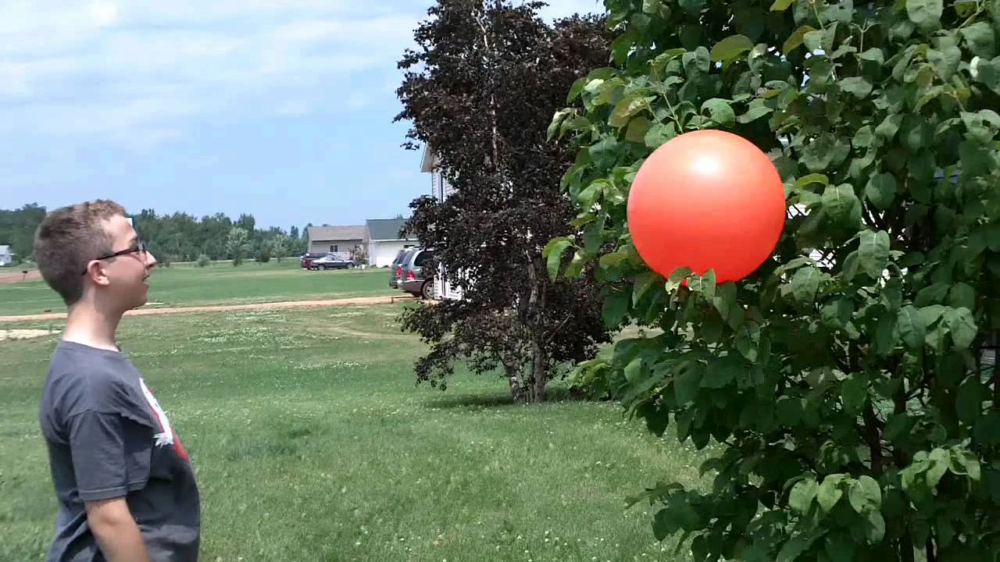

In [19]:
im = Image.open('ball.jpeg')
display(im)

out = im.point(lambda i: i + np.random.normal(0,1))
display(out)

Estas imágenes nos parecen idénticas pero son ien diferentes para la computadora.